<a href="https://colab.research.google.com/github/panimesh14/Deep-Learning-/blob/main/LSTM_RNN_Model_for_Multivariate_Time_Series_Prediction_of_Appliance_Energy_Usage.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Multivariate Prediction using LSTM RNN for Appliance Energy Usage Prediction


#Attribute Information:
date time year-month-day hour:minute:second
Appliances, energy use in Wh
lights, energy use of light fixtures in the house in Wh
T1, Temperature in kitchen area, in Celsius
RH_1, Humidity in kitchen area, in %
T2, Temperature in living room area, in Celsius
RH_2, Humidity in living room area, in %
T3, Temperature in laundry room area
RH_3, Humidity in laundry room area, in %
T4, Temperature in office room, in Celsius
RH_4, Humidity in office room, in %
T5, Temperature in bathroom, in Celsius
RH_5, Humidity in bathroom, in %
T6, Temperature outside the building (north side), in Celsius
RH_6, Humidity outside the building (north side), in %
T7, Temperature in ironing room , in Celsius
RH_7, Humidity in ironing room, in %
T8, Temperature in teenager room 2, in Celsius
RH_8, Humidity in teenager room 2, in %
T9, Temperature in parents room, in Celsius
RH_9, Humidity in parents room, in %
To, Temperature outside (from Chievres weather station), in Celsius
Pressure (from Chievres weather station), in mm Hg
RH_out, Humidity outside (from Chievres weather station), in %
Wind speed (from Chievres weather station), in m/s
Visibility (from Chievres weather station), in km
Tdewpoint (from Chievres weather station), Â°C
rv1, Random variable 1, nondimensional
rv2, Random variable 2, nondimensional

In [76]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [77]:
#Reading/Loading Data
energy_df=pd.read_csv('energydata_complete.csv')
energy_df.head(2)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.7900,19.79,44.73,19.0,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.7225,19.79,44.79,19.0,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195


In [78]:

#making datetime as index
df=pd.read_csv('energydata_complete.csv',index_col='date',infer_datetime_format=True)

DATA EXPLORATION

In [79]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19735 entries, 2016-01-11 17:00:00 to 2016-05-27 18:00:00
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19735 non-null  int64  
 1   lights       19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T6           19735 non-null  float64
 13  RH_6         19735 non-null  float64
 14  T7           19735 non-null  float64
 15  RH_7         19735 non-null  float64
 16  T8           19735 non-null  float64
 17  RH_8         19735 non-null  float64
 18  T9           19735 

In [80]:
df.head(5)

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [81]:
df.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [82]:
#Exploratory Data Analysis
df=round(df,2)#rounding to 2 decimal places
df.head(2)

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60,30,19.89,47.60,19.2,44.79,19.79,44.73,19.0,45.57,...,17.03,45.53,6.60,733.5,92.0,7.00,63.00,5.3,13.28,13.28
2016-01-11 17:10:00,60,30,19.89,46.69,19.2,44.72,19.79,44.79,19.0,45.99,...,17.07,45.56,6.48,733.6,92.0,6.67,59.17,5.2,18.61,18.61


In [83]:
#sns.heatmap(df.isna(),annot=True)
#Null values seems absent confirming results from .info()

In [84]:
df.nunique()
#appliances, light seem categorical values, cross confirmed by info() which shows integral whole number values with rest as floating point and datetime

Appliances       92
lights            8
T1              508
RH_1           1481
T2              914
RH_2           1803
T3              807
RH_3           1283
T4              751
RH_4           1570
T5              853
RH_5           3482
T6             2409
RH_6           6014
T7              904
RH_7           2144
T8              975
RH_8           2246
T9              588
RH_9           1692
T_out          1673
Press_mm_hg    2123
RH_out          566
Windspeed       189
Visibility      412
Tdewpoint      1333
rv1            4903
rv2            4903
dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


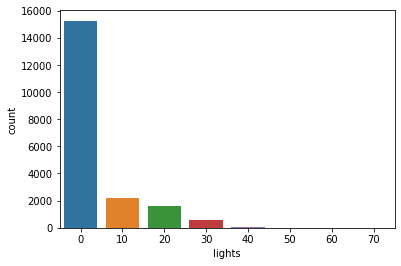

In [85]:
sns.countplot(df['lights'])

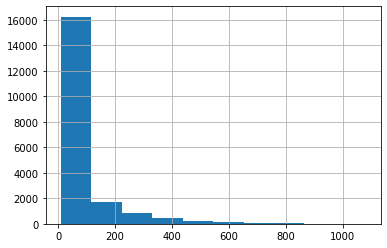

In [86]:
df['Appliances'].hist()
#getting dummies for such large number of variables could be difficult to manage and make computation expensive
#One way could be to group them by some factor
#As it is given time series, individual samples cannot be filtered or dropped here

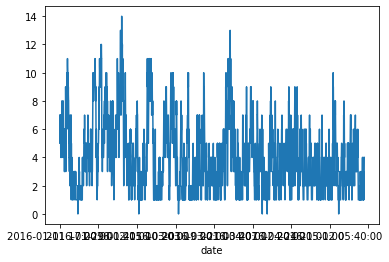

In [145]:
df['Windspeed'].plot()

In [87]:
#Data Preparation

In [88]:
#Drppping categorical variables for simplicity
df.drop(['Appliances','lights'],axis=1,inplace=True)

In [89]:
df.head(1)

,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,19.89,47.6,19.2,44.79,19.79,44.73,19.0,45.57,17.17,55.2,...,17.03,45.53,6.6,733.5,92.0,7.0,63.0,5.3,13.28,13.28


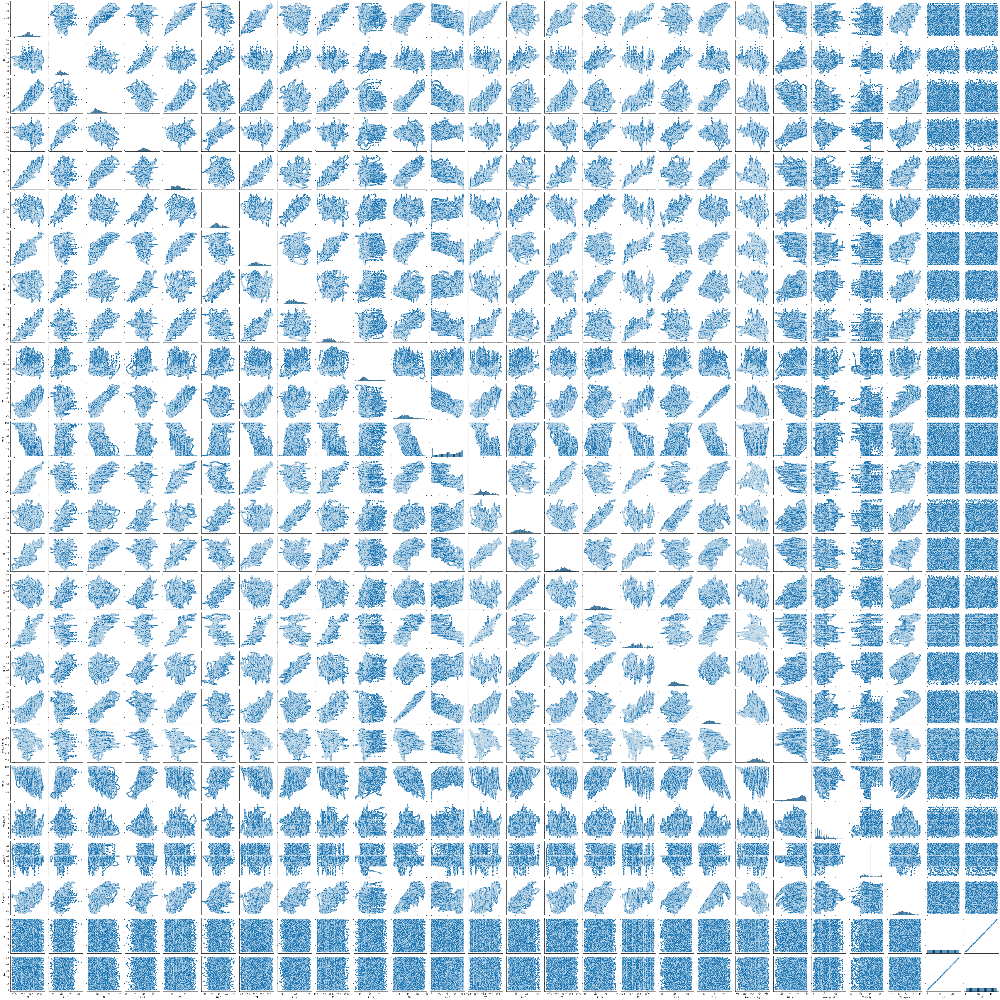

In [146]:
#A basic visual peak into correlations
sns.pairplot(df)
#rv1, rv2 are well correlated with each other but poorly correlated to any other variable which is understandable as they are random variables for testing. 
#Most parameters show more or less good correlation with each other

In [90]:
#number of readings per day
numread=24*(60/10);#reading per 10 minutes per day
numread

144.0

In [91]:
#train test data extraction
test_days=2;#prediction period
test_ind=int(test_days*numread);#samples or number of indices required for prediction period
train_df = df.iloc[:-test_ind];#training data
test_df = df.iloc[-test_ind:];#testing data
test_ind

288

#Scaling and Normalization

In [92]:
#Scaling and Normalization
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
scaler.fit(train_df)
scaled_train_df=scaler.transform(train_df);
scaled_test_df=scaler.transform(test_df);

Time Series Generator

In [93]:
#Time Series Generator for generating sequences and batches
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
seq_length=144;#number of ordered data points to predict next term
batch_size=1;#number of timeseries samples to be predicted in each batch
#Train Generator
train_generator=TimeseriesGenerator(scaled_train_df,scaled_train_df,length=seq_length,batch_size=batch_size)
#validation_generator
validation_generator=TimeseriesGenerator(scaled_test_df,scaled_test_df,length=seq_length,batch_size=batch_size)
#Test Generator
test_generator=TimeseriesGenerator(scaled_test_df,scaled_test_df,length=seq_length,batch_size=batch_size)

In [94]:
X,y=train_generator[0];
print('number of data points, features',scaled_train_df.shape)
print('Input Sequence:',X)
print('Output Batch:',y)
print('output batch shape',y.shape)
# Multivariate batch giving values for all parameters/fields at the new time sample using previous time sample points in the sequence

number of data points, features (19447, 26)
Input Sequence: [[[0.32734952 0.56631811 0.2252907  ... 0.53846154 0.26545309 0.26545309]
  [0.32734952 0.54127683 0.2252907  ... 0.53393665 0.37207441 0.37207441]
  [0.32734952 0.53054485 0.2252907  ... 0.52941176 0.57271454 0.57271454]
  ...
  [0.34952482 0.45156852 0.21802326 ... 0.42986425 0.6015203  0.6015203 ]
  [0.34952482 0.44413869 0.21366279 ... 0.42081448 0.23864773 0.23864773]
  [0.34952482 0.44056136 0.21148256 ... 0.41176471 0.25805161 0.25805161]]]
Output Batch: [[0.34635692 0.43505779 0.21075581 0.61737419 0.21511628 0.74474053
  0.37477477 0.63593683 0.21680993 0.31699248 0.35574964 0.76734075
  0.25918944 0.52163121 0.20970696 0.55483208 0.22996878 0.58319536
  0.36977492 0.34651163 0.67105263 0.5        0.43076923 0.40271493
  0.72934587 0.72934587]]
output batch shape (1, 26)


#MODEL BUILDING

In [95]:
#Model Building
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,LSTM
num_features=scaled_train_df.shape[1];
energy_model=Sequential()
#LSTM model
hidden_state=25;
energy_model.add(LSTM(hidden_state,input_shape=(seq_length,num_features)))
#Dense MLP
energy_model.add(Dense(num_features))#one output required for each feature at any time sample
energy_model.compile(optimizer='adam',loss='mse',metrics=['accuracy'])
energy_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 25)                5200      
                                                                 
 dense_2 (Dense)             (None, 26)                676       
                                                                 
Total params: 5,876
Trainable params: 5,876
Non-trainable params: 0
_________________________________________________________________


In [96]:
#Early Stopping Regularization
from tensorflow.keras.callbacks import EarlyStopping
early_stop=EarlyStopping(monitor='val_loss',patience=2)

Model Training

In [98]:
energy_model.fit(train_generator,epochs=6,validation_data=validation_generator,callbacks=[early_stop])

Epoch 1/6
19303/19303 [==============================] - 929s 48ms/step - loss: 0.0068 - accuracy: 0.7844 - val_loss: 0.0068 - val_accuracy: 0.7708
Epoch 2/6
19303/19303 [==============================] - 921s 48ms/step - loss: 0.0067 - accuracy: 0.7894 - val_loss: 0.0068 - val_accuracy: 0.7222
Epoch 3/6
19303/19303 [==============================] - 925s 48ms/step - loss: 0.0067 - accuracy: 0.7935 - val_loss: 0.0068 - val_accuracy: 0.7222
Epoch 4/6
19303/19303 [==============================] - 915s 47ms/step - loss: 0.0067 - accuracy: 0.7932 - val_loss: 0.0067 - val_accuracy: 0.7917
Epoch 5/6
19303/19303 [==============================] - 910s 47ms/step - loss: 0.0067 - accuracy: 0.7957 - val_loss: 0.0069 - val_accuracy: 0.7292
Epoch 6/6
19303/19303 [==============================] - 899s 47ms/step - loss: 0.0067 - accuracy: 0.7972 - val_loss: 0.0067 - val_accuracy: 0.7847


78.47% accuracy on validation and 79.72% on training data

In [135]:
energy_model_history_fn = pd.DataFrame(energy_model.history.history)
#plt.subplot(2,1,1)
energy_model_history_fn
#plt.subplot(2,1,2)
#energy_model_history_fn.plot(['loss','val_loss'])
#accuracy may further be increased on increasing prediction period for validation which could be expanded
#number of hidden states for LSTM could be changed given computational cost may increase

""


MODEL TESTING

In [100]:
#Model Testing and Prediction
test_predictions=[];
first_eval_batch=scaled_train_df[-seq_length:];
current_eval_batch=first_eval_batch.reshape((1,seq_length,num_features));
for i in range(test_ind):
    current_pred=energy_model.predict(current_eval_batch)[0]
    test_predictions.append((current_pred))
    current_eval_batch=np.append(current_eval_batch[:,1:,:],[[current_pred]],axis=1)

In [106]:
#Inverse TRANSFORMED PREDICTIONS
y_hat=scaler.inverse_transform(test_predictions);

In [115]:
test_predictions[0]

array([8.1324673e-01, 2.8847942e-01, 5.9444815e-01, 4.1739982e-01,
       6.6141033e-01, 3.6085308e-01, 8.3688223e-01, 4.4019705e-01,
       5.6123388e-01, 3.5683298e-01, 7.3730624e-01, 7.3078275e-04,
       7.5176948e-01, 4.0441203e-01, 7.5058115e-01, 3.1906229e-01,
       7.3875773e-01, 3.3641827e-01, 7.0961261e-01, 6.2699431e-01,
       4.3032098e-01, 1.5757941e-01, 6.2940377e-01, 6.5863156e-01,
       4.7450119e-01, 4.7369409e-01], dtype=float32)

In [108]:
#TRUE TEST DATA
test_df

,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,
2016-05-25 18:10:00,24.50,37.86,24.00,34.27,25.00,36.70,24.29,37.79,21.20,51.37,...,22.00,37.23,16.48,756.1,55.83,2.00,38.17,7.62,38.14,38.14
2016-05-25 18:20:00,24.50,37.30,23.86,34.33,24.94,36.67,24.29,37.79,21.29,51.14,...,22.00,37.36,16.47,756.1,55.67,2.00,36.33,7.53,31.16,31.16
2016-05-25 18:30:00,24.50,36.96,23.73,34.33,24.85,36.50,24.29,37.79,21.32,50.73,...,22.03,37.39,16.45,756.1,55.50,2.00,34.50,7.45,4.40,4.40
2016-05-25 18:40:00,24.50,37.00,23.70,34.40,24.84,36.45,24.29,37.90,21.39,50.35,...,22.10,37.72,16.43,756.1,55.33,2.00,32.67,7.37,27.12,27.12
2016-05-25 18:50:00,24.49,37.07,23.68,34.52,24.84,36.49,24.28,37.93,21.39,50.35,...,22.10,37.81,16.42,756.1,55.17,2.00,30.83,7.28,10.27,10.27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-05-27 17:20:00,25.57,46.56,25.89,42.03,27.20,41.16,24.70,45.59,23.20,52.40,...,23.20,46.79,22.73,755.2,55.67,3.33,23.67,13.33,43.10,43.10
2016-05-27 17:30:00,25.50,46.50,25.75,42.08,27.13,41.22,24.70,45.59,23.23,52.33,...,23.20,46.79,22.60,755.2,56.00,3.50,24.50,13.30,49.28,49.28
2016-05-27 17:40:00,25.50,46.60,25.63,42.77,27.05,41.69,24.70,45.73,23.23,52.27,...,23.20,46.79,22.47,755.2,56.33,3.67,25.33,13.27,29.20,29.20


In [137]:
#PREDICTED TEST DATA
y_hat
pred_yhat=pd.DataFrame(y_hat,index=test_df.index,columns=test_df.columns)
pred_yhat
#Values seem quite close to the test_df data

,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,
2016-05-25 18:10:00,24.491447,37.503342,24.279607,35.306912,25.163380,36.488647,24.389393,37.973817,21.206119,53.549393,...,21.989462,37.297865,17.068952,756.260755,56.704394,2.206112,41.911245,7.955758,23.730315,23.689967
2016-05-25 18:20:00,24.591625,37.343135,24.401510,35.352497,25.196415,36.215426,24.549655,38.045459,21.350354,56.732961,...,22.040175,37.154434,17.332300,756.168459,56.321527,2.418985,43.088796,8.167418,23.678269,23.671514
2016-05-25 18:30:00,24.704062,37.232359,24.509425,35.375784,25.220670,35.956264,24.703984,38.116114,21.486710,59.821150,...,22.106524,37.055452,17.583292,756.092528,55.960128,2.619176,43.473123,8.368702,23.625814,23.648051
2016-05-25 18:40:00,24.825548,37.139195,24.612286,35.421114,25.237482,35.718434,24.856524,38.188794,21.613233,62.799475,...,22.182862,36.989689,17.819817,756.062812,55.662292,2.809604,43.419887,8.560589,23.572224,23.634583
2016-05-25 18:50:00,24.950866,37.048288,24.709017,35.478593,25.244804,35.499092,25.002836,38.260849,21.727883,65.662448,...,22.263057,36.948763,18.035781,756.067782,55.406112,2.988180,43.025103,8.738362,23.517567,23.626653
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-05-27 17:20:00,20.218733,41.660490,20.008965,37.243511,17.703638,40.418883,18.590114,32.458972,13.357046,97.452400,...,14.355051,54.724923,4.581838,758.596291,99.621065,4.637917,30.777832,5.790381,24.264596,23.037984
2016-05-27 17:30:00,20.218726,41.660530,20.008976,37.243510,17.703627,40.418904,18.590122,32.459004,13.357038,97.452368,...,14.355050,54.724932,4.581822,758.596279,99.621083,4.637900,30.777857,5.790377,24.264601,23.037984
2016-05-27 17:40:00,20.218718,41.660573,20.008987,37.243513,17.703616,40.418925,18.590128,32.459036,13.357029,97.452336,...,14.355049,54.724946,4.581809,758.596271,99.621110,4.637884,30.777904,5.790373,24.264607,23.037986


Text(0, 0.5, 'Time')

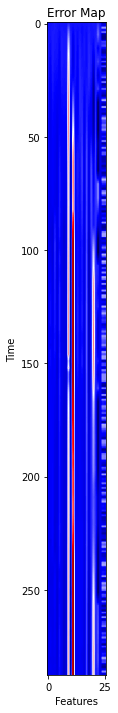

In [144]:
error=pred_yhat-test_df;
plt.figure(figsize=(6,12))
plt.imshow(error,cmap='seismic')#image displaying errors
plt.title("Error Map")
plt.xlabel('Features')#26 or 0 to 25
plt.ylabel('Time')#288 time samples 
#A few variables/parameters demonstrate more error than the rest which may be accounted for by either dropping them or checking their correlation with each other